# Author: Yaffazka Afazillah Wijaya
### Subject: Data Science for Industry

In [373]:
import io
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Read Data

In [374]:
pd.read_csv('dataset-tugas.csv')

,IDKonsumen,IDProduk,Kuantitas,Harga,TglTransaksi,Pembayaran,LokasiToko,KategoriProduk,Diskon,JumlahTotal
0,"109318,C,7,80.07984415,12/26/2023 12:32,Cash,""...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,"Baileyfort, HI 93354"",Books,18.6770995,455.862...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,"993229,C,4,75.19522942,8/5/2023 0:00,Cash,""116...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,"East Kara, MT 19483"",Home Decor,14.12136502,25...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,"579675,A,8,31.52881648,3/11/2024 18:51,Cash,""9...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
199995,"Stephanieborough, RI 94492"",Clothing,17.423979...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
199996,"326401,C,5,66.54223948,2/5/2024 19:45,PayPal,""...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
199997,"Barnettside, PR 50529"",Electronics,14.34501785...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
199998,"771566,C,5,38.08776628,2/4/2024 11:53,Debit Ca...",NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Data Cleaning

In [375]:
raw_data = list(pd.read_csv('dataset-tugas.csv')["IDKonsumen"])

print("Data Length:",len(raw_data))

Data Length: 200000


In [376]:
def join_with_fixline(data):
    corrected_rows = []
    temp_row = ""
    
    for row in data:
        temp_row += row
        if temp_row.count('"') % 2 == 0:
            corrected_rows.append(temp_row)
            temp_row = ""
        else:
            temp_row += ' '
    
    if temp_row:
        corrected_rows.append(temp_row) 
    
    return corrected_rows

In [377]:
corrected_data = join_with_fixline(raw_data)
print(corrected_data)

['109318,C,7,80.07984415,12/26/2023 12:32,Cash,"176 Andrew Cliffs Baileyfort, HI 93354",Books,18.6770995,455.8627638', '993229,C,4,75.19522942,8/5/2023 0:00,Cash,"11635 William Well Suite 809 East Kara, MT 19483",Home Decor,14.12136502,258.3065464', '579675,A,8,31.52881648,3/11/2024 18:51,Cash,"910 Mendez Ville Suite 909 Port Lauraland, MO 99563",Books,15.94370066,212.0156509', '799826,D,5,98.88021828,10/27/2023 22:00,PayPal,"87522 Sharon Corners Suite 500 Lake Tammy, MO 76234",Books,6.68633678,461.3437694', '121413,A,7,93.18851246,12/22/2023 11:38,Cash,"0070 Michelle Island Suite 143 Holand, VA 80142",Electronics,4.030095691,626.0304837', '463050,D,3,54.09315249,8/15/2023 4:24,Cash,"8492 Jonathan Drive North Robertshire, TN 67532",Electronics,10.88876836,144.6092233', '888163,D,7,13.12193739,12/26/2023 5:32,PayPal,"USNV Harrell FPO AA 62814",Clothing,16.29512671,76.88590745', '843385,A,8,56.02516419,10/11/2023 6:48,Debit Card,"489 Juan Loop Apt. 093 North Brettville, WV 72610",Home De

In [378]:
corrected_data = join_with_fixline(raw_data)
corrected_csv_string = '\n'.join(corrected_data)
print(corrected_csv_string)

109318,C,7,80.07984415,12/26/2023 12:32,Cash,"176 Andrew Cliffs Baileyfort, HI 93354",Books,18.6770995,455.8627638
993229,C,4,75.19522942,8/5/2023 0:00,Cash,"11635 William Well Suite 809 East Kara, MT 19483",Home Decor,14.12136502,258.3065464
579675,A,8,31.52881648,3/11/2024 18:51,Cash,"910 Mendez Ville Suite 909 Port Lauraland, MO 99563",Books,15.94370066,212.0156509
799826,D,5,98.88021828,10/27/2023 22:00,PayPal,"87522 Sharon Corners Suite 500 Lake Tammy, MO 76234",Books,6.68633678,461.3437694
121413,A,7,93.18851246,12/22/2023 11:38,Cash,"0070 Michelle Island Suite 143 Holand, VA 80142",Electronics,4.030095691,626.0304837
463050,D,3,54.09315249,8/15/2023 4:24,Cash,"8492 Jonathan Drive North Robertshire, TN 67532",Electronics,10.88876836,144.6092233
888163,D,7,13.12193739,12/26/2023 5:32,PayPal,"USNV Harrell FPO AA 62814",Clothing,16.29512671,76.88590745
843385,A,8,56.02516419,10/11/2023 6:48,Debit Card,"489 Juan Loop Apt. 093 North Brettville, WV 72610",Home Decor,6.344305684,419.766

In [379]:
headers = "IDKonsumen,IDProduk,Kuantitas,Harga,TglTransaksi,Pembayaran,LokasiToko,KategoriProduk,Diskon,JumlahTotal\n"
corrected_csv_string = headers + corrected_csv_string
data = io.StringIO(corrected_csv_string)

In [380]:
df = pd.read_csv(data, quotechar='"', skipinitialspace=True)
df

,IDKonsumen,IDProduk,Kuantitas,Harga,TglTransaksi,Pembayaran,LokasiToko,KategoriProduk,Diskon,JumlahTotal
0,109318,C,7,80.079844,12/26/2023 12:32,Cash,"176 Andrew Cliffs Baileyfort, HI 93354",Books,18.677100,455.862764
1,993229,C,4,75.195229,8/5/2023 0:00,Cash,"11635 William Well Suite 809 East Kara, MT 19483",Home Decor,14.121365,258.306546
2,579675,A,8,31.528816,3/11/2024 18:51,Cash,"910 Mendez Ville Suite 909 Port Lauraland, MO ...",Books,15.943701,212.015651
3,799826,D,5,98.880218,10/27/2023 22:00,PayPal,"87522 Sharon Corners Suite 500 Lake Tammy, MO ...",Books,6.686337,461.343769
4,121413,A,7,93.188512,12/22/2023 11:38,Cash,"0070 Michelle Island Suite 143 Holand, VA 80142",Electronics,4.030096,626.030484
...,...,...,...,...,...,...,...,...,...,...
99995,726461,A,2,56.078258,7/17/2023 16:59,Credit Card,"3632 Darren Station Apt. 553 Ericaborough, RI ...",Clothing,18.345145,91.581240
99996,328056,A,6,88.516406,5/30/2023 9:04,Credit Card,"821 Taylor Shoals Evansville, IL 70845",Electronics,3.995541,509.878179
99997,887304,B,4,72.385564,8/25/2023 7:59,Credit Card,"50653 Kara Lakes Stephanieborough, RI 94492",Clothing,17.423979,239.092472
99998,326401,C,5,66.542239,2/5/2024 19:45,PayPal,"18756 Mcfarland Way Suite 866 Barnettside, PR ...",Electronics,14.345018,284.983717


In [381]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 10 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   IDKonsumen      100000 non-null  int64  
 1   IDProduk        100000 non-null  object 
 2   Kuantitas       100000 non-null  int64  
 3   Harga           100000 non-null  float64
 4   TglTransaksi    100000 non-null  object 
 5   Pembayaran      100000 non-null  object 
 6   LokasiToko      100000 non-null  object 
 7   KategoriProduk  100000 non-null  object 
 8   Diskon          100000 non-null  float64
 9   JumlahTotal     100000 non-null  float64
dtypes: float64(3), int64(2), object(5)
memory usage: 7.6+ MB


# Exploratory Data Analysis

## Data Description

In [382]:
df.describe()

,IDKonsumen,Kuantitas,Harga,Diskon,JumlahTotal
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000
mean,500463.982180,5.009290,55.067344,10.020155,248.334955
std,288460.917524,2.579808,25.971567,5.779534,184.554792
min,14.000000,1.000000,10.000430,0.000046,8.274825
25%,250693.750000,3.000000,32.549474,5.001013,95.163418
50%,499679.000000,5.000000,55.116789,10.030353,200.368393
75%,751104.750000,7.000000,77.456763,15.018367,362.009980
max,999997.000000,9.000000,99.999284,19.999585,896.141242


In [383]:
# Set up the plotting environment
sns.set(style="whitegrid")

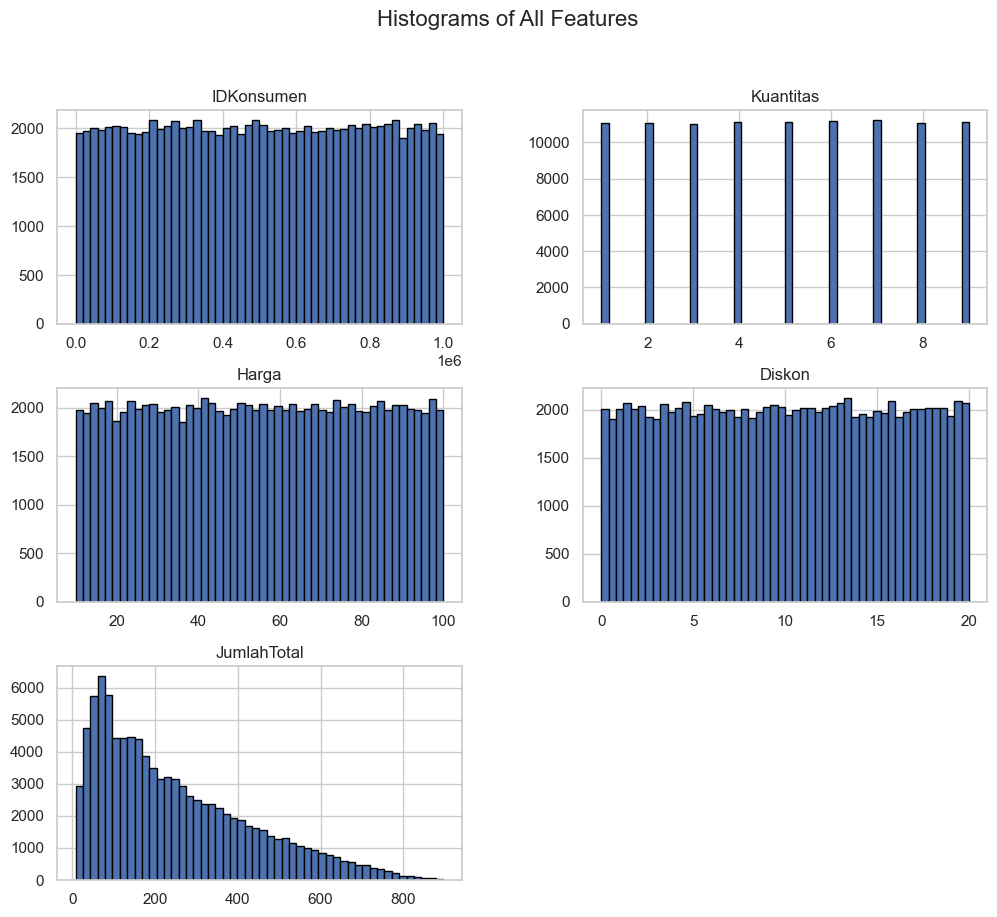

In [384]:
# Visualize data distributions using histograms
df.hist(figsize=(12, 10), bins=50, edgecolor='black')
plt.suptitle('Histograms of All Features', fontsize=16)
plt.show()

In [385]:
from sklearn.preprocessing import StandardScaler

sc = StandardScaler()


datas = df[['IDKonsumen', 'Kuantitas', 'Harga', 'Diskon', 'JumlahTotal']]

sc.fit(datas)

data_scaled = pd.DataFrame(sc.transform(datas))

numerical_header_scaled = list(data_scaled.columns.values)

data_scaled.rename(columns={numerical_header_scaled[0]:'IDKonsumen',
                            numerical_header_scaled[1]:'Kuantitas', 
                            numerical_header_scaled[2]:'Harga', 
                            numerical_header_scaled[3]:'Diskon', 
                            numerical_header_scaled[4]:'JumlahTotal'}, 
                            inplace=True)

In [386]:
data_scaled

,IDKonsumen,Kuantitas,Harga,Diskon,JumlahTotal
0,-1.355982,0.771654,0.963077,1.497870,1.124484
1,1.708264,-0.391229,0.775001,0.709613,0.054031
2,0.274600,1.159282,-0.906324,1.024923,-0.196795
3,1.037796,-0.003601,1.686964,-0.576835,1.154182
4,-1.314053,0.771654,1.467811,-1.036431,2.046533
...,...,...,...,...,...
99995,0.783462,-1.166484,0.038924,1.440433,-0.849366
99996,-0.597685,0.384027,1.287917,-1.042410,1.417165
99997,1.341055,-0.391229,0.666818,1.281048,-0.050080
99998,-0.603423,-0.003601,0.441827,0.748310,0.198580


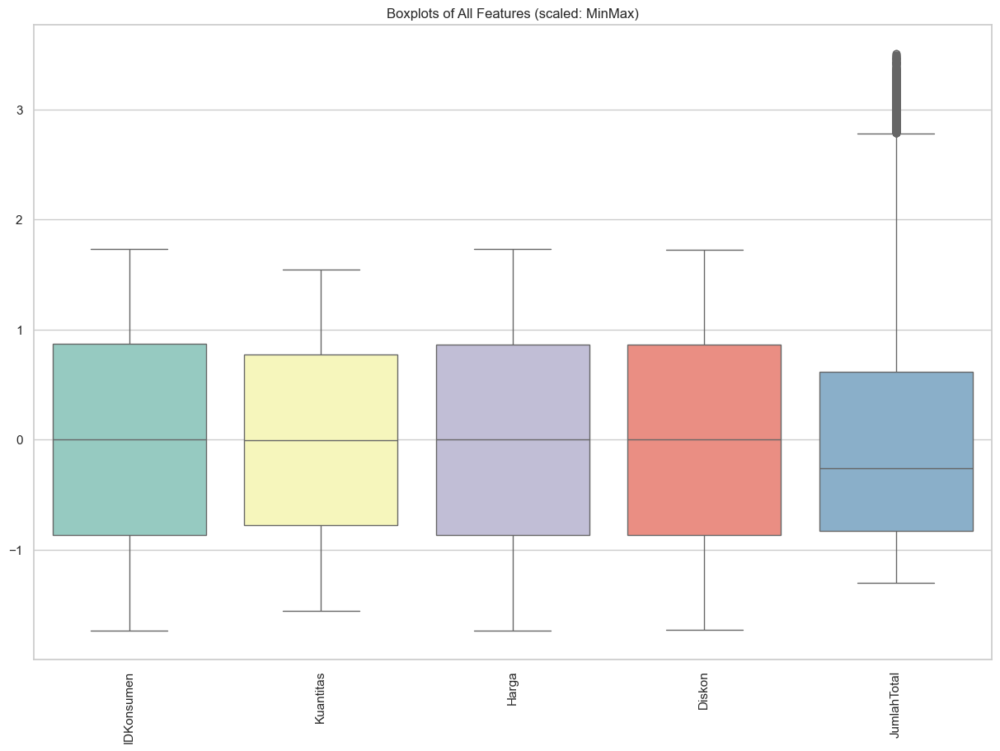

In [387]:
plt.figure(figsize=(15, 10))
sns.boxplot(data=data_scaled, palette="Set3")
plt.title('Boxplots of All Features (scaled: MinMax)')
plt.xticks(rotation=90)
plt.show()

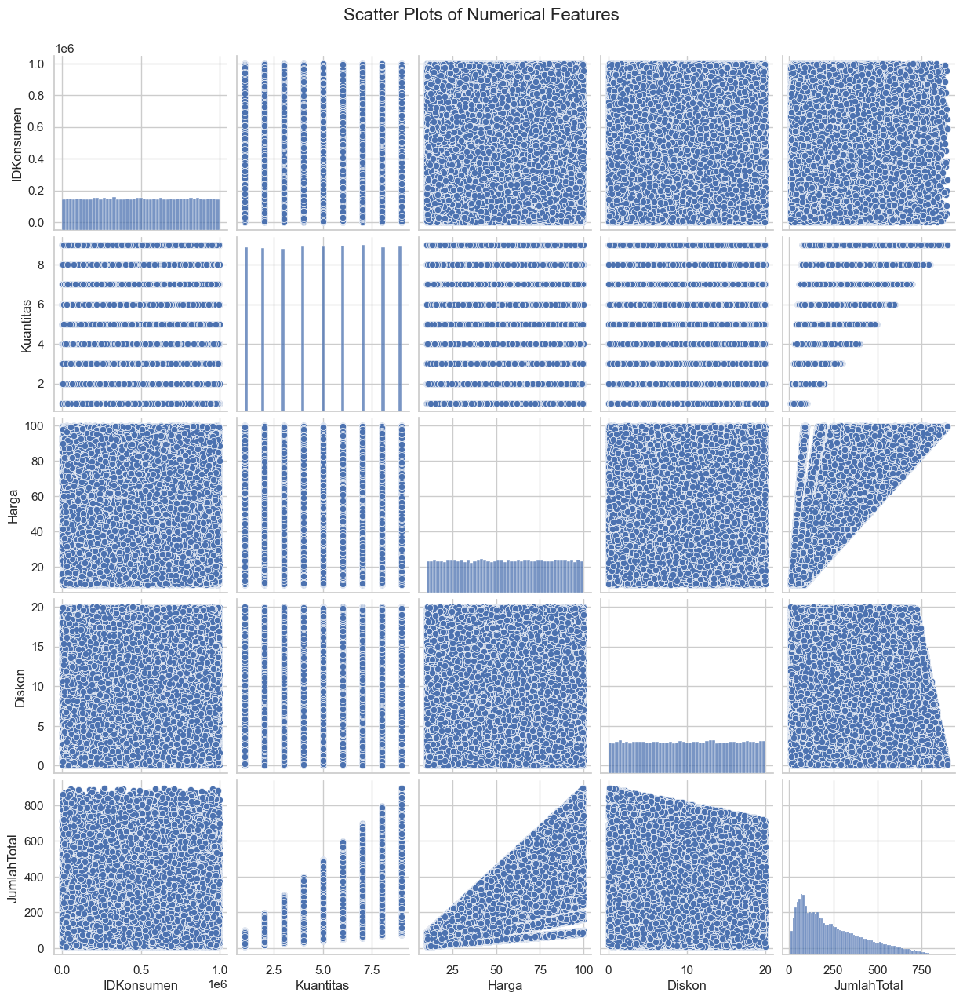

In [388]:
numerical_header = list(data_scaled.columns.values)

pairplot = sns.pairplot(df[numerical_header])
pairplot.fig.suptitle('Scatter Plots of Numerical Features', fontsize=16, y=1.02)
plt.show()

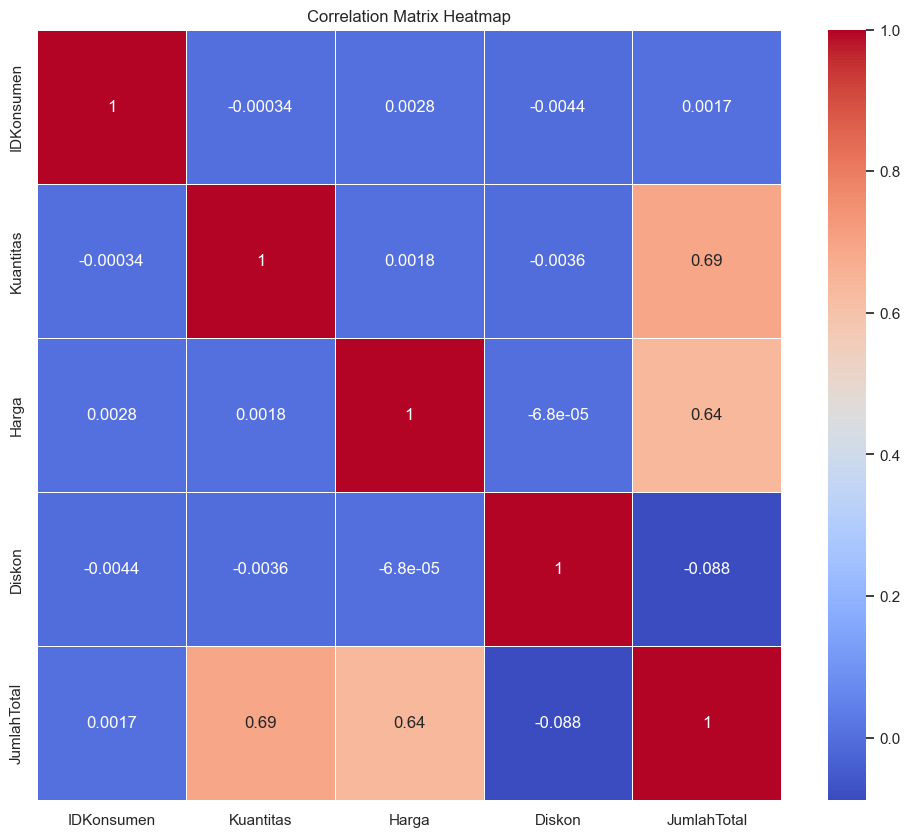

In [389]:
# Visualize correlations using a heatmap
correlation_matrix = df[numerical_header].corr()

plt.figure(figsize=(12, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', linewidths=0.5)
plt.title('Correlation Matrix Heatmap')
plt.show()

## Data Transformation

In [390]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 10 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   IDKonsumen      100000 non-null  int64  
 1   IDProduk        100000 non-null  object 
 2   Kuantitas       100000 non-null  int64  
 3   Harga           100000 non-null  float64
 4   TglTransaksi    100000 non-null  object 
 5   Pembayaran      100000 non-null  object 
 6   LokasiToko      100000 non-null  object 
 7   KategoriProduk  100000 non-null  object 
 8   Diskon          100000 non-null  float64
 9   JumlahTotal     100000 non-null  float64
dtypes: float64(3), int64(2), object(5)
memory usage: 7.6+ MB


In [391]:
print(df.head())

   IDKonsumen IDProduk  Kuantitas      Harga      TglTransaksi Pembayaran  \
0      109318        C          7  80.079844  12/26/2023 12:32       Cash   
1      993229        C          4  75.195229     8/5/2023 0:00       Cash   
2      579675        A          8  31.528816   3/11/2024 18:51       Cash   
3      799826        D          5  98.880218  10/27/2023 22:00     PayPal   
4      121413        A          7  93.188512  12/22/2023 11:38       Cash   

                                          LokasiToko KategoriProduk  \
0             176 Andrew Cliffs Baileyfort, HI 93354          Books   
1   11635 William Well Suite 809 East Kara, MT 19483     Home Decor   
2  910 Mendez Ville Suite 909 Port Lauraland, MO ...          Books   
3  87522 Sharon Corners Suite 500 Lake Tammy, MO ...          Books   
4    0070 Michelle Island Suite 143 Holand, VA 80142    Electronics   

      Diskon  JumlahTotal  
0  18.677100   455.862764  
1  14.121365   258.306546  
2  15.943701   212.015651 

In [392]:
# Drop column named IDKonsumen, TglTransaksi, LokasiToko 
print(df['KategoriProduk'].unique()) # array(['Books', 'Home Decor', 'Electronics', 'Clothing'], dtype=object) to [0,1,2,3]
print(df['Pembayaran'].unique()) # array(['Cash', 'PayPal', 'Debit Card', 'Credit Card'], dtype=object) to [0,1,2,3]
print(sorted(df['IDProduk'].unique())) # ['A', 'B', 'C', 'D'] to [0,1,2,3], so A is 0, B is 1, and so on



['Books' 'Home Decor' 'Electronics' 'Clothing']
['Cash' 'PayPal' 'Debit Card' 'Credit Card']
['A', 'B', 'C', 'D']


In [393]:
encoded_data = df.copy()
encoded_data = encoded_data.drop(['IDKonsumen', 'TglTransaksi', 'LokasiToko'], axis=1)

In [394]:
encoded_data

,IDProduk,Kuantitas,Harga,Pembayaran,KategoriProduk,Diskon,JumlahTotal
0,C,7,80.079844,Cash,Books,18.677100,455.862764
1,C,4,75.195229,Cash,Home Decor,14.121365,258.306546
2,A,8,31.528816,Cash,Books,15.943701,212.015651
3,D,5,98.880218,PayPal,Books,6.686337,461.343769
4,A,7,93.188512,Cash,Electronics,4.030096,626.030484
...,...,...,...,...,...,...,...
99995,A,2,56.078258,Credit Card,Clothing,18.345145,91.581240
99996,A,6,88.516406,Credit Card,Electronics,3.995541,509.878179
99997,B,4,72.385564,Credit Card,Clothing,17.423979,239.092472
99998,C,5,66.542239,PayPal,Electronics,14.345018,284.983717


In [395]:
encoded_data = pd.DataFrame(encoded_data)

In [396]:
encoded_data.isnull().sum()

IDProduk          0
Kuantitas         0
Harga             0
Pembayaran        0
KategoriProduk    0
Diskon            0
JumlahTotal       0
dtype: int64

In [397]:
# Mapping dictionaries
product_map = {'Books': 0, 'Home Decor': 1, 'Electronics': 2, 'Clothing': 3}
payment_map = {'Cash': 0, 'PayPal': 1, 'Debit Card': 2, 'Credit Card': 3}
product_id_map = {'A': 0, 'B': 1, 'C': 2, 'D': 3}

if 'KategoriProduk' in encoded_data.columns:
    encoded_data['KategoriProduk'] = encoded_data['KategoriProduk'].map(product_map)

if 'Pembayaran' in encoded_data.columns:
    encoded_data['Pembayaran'] = encoded_data['Pembayaran'].map(payment_map)

if 'IDProduk' in encoded_data.columns:
    encoded_data['IDProduk'] = encoded_data['IDProduk'].map(product_id_map)

# Print encoded_data to verify the transformation
encoded_data

,IDProduk,Kuantitas,Harga,Pembayaran,KategoriProduk,Diskon,JumlahTotal
0,2,7,80.079844,0,0,18.677100,455.862764
1,2,4,75.195229,0,1,14.121365,258.306546
2,0,8,31.528816,0,0,15.943701,212.015651
3,3,5,98.880218,1,0,6.686337,461.343769
4,0,7,93.188512,0,2,4.030096,626.030484
...,...,...,...,...,...,...,...
99995,0,2,56.078258,3,3,18.345145,91.581240
99996,0,6,88.516406,3,2,3.995541,509.878179
99997,1,4,72.385564,3,3,17.423979,239.092472
99998,2,5,66.542239,1,2,14.345018,284.983717


In [398]:
encoded_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 7 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   IDProduk        100000 non-null  int64  
 1   Kuantitas       100000 non-null  int64  
 2   Harga           100000 non-null  float64
 3   Pembayaran      100000 non-null  int64  
 4   KategoriProduk  100000 non-null  int64  
 5   Diskon          100000 non-null  float64
 6   JumlahTotal     100000 non-null  float64
dtypes: float64(3), int64(4)
memory usage: 5.3 MB


In [399]:
encoded_data.head()

,IDProduk,Kuantitas,Harga,Pembayaran,KategoriProduk,Diskon,JumlahTotal
0,2,7,80.079844,0,0,18.677100,455.862764
1,2,4,75.195229,0,1,14.121365,258.306546
2,0,8,31.528816,0,0,15.943701,212.015651
3,3,5,98.880218,1,0,6.686337,461.343769
4,0,7,93.188512,0,2,4.030096,626.030484


In [400]:
# encoded_data.to_csv('encoded_data.csv', index=False)
# pd.read_csv('encoded_data.csv')

# Prediction Model

## Model Selection

For model selection, i use `PyCaret` as a tool/library for evaluation which is the better model for the data using regression method. For documentation you may visit the official documentation: https://pycaret.gitbook.io/docs. And also check the source code for the testing: https://colab.research.google.com/drive/1QqoeNRf7QWvPmvUYwVRISBCsWYTOAdz5?usp=sharing.


`from pycaret.regression import *`

`exp_reg = setup(data=encoded_data, target='JumlahTotal')`

`best_model = compare_models()`

`model = create_model('ridge')`

`tuned_model = tune_model(model)`

`evaluate_model(tuned_model)`

![alt text](model-selection-report.png "Model Selection Report")

### Analysis:

- **Lowest MAE**: Extra Trees Regressor (et) has the lowest Mean Absolute Error, indicating it predicts the target variable closest to the actual values on average.
- **Lowest RMSE**: Extra Trees Regressor (et) also has the lowest Root Mean Squared Error, which is another measure of prediction accuracy.
- **Highest R2**: Random Forest Regressor (rf), Extra Trees Regressor (et), and Decision Tree Regressor (dt) have the highest R-squared values, indicating they explain the variance in the target variable very well.

### Conclusion:

Based on these metrics, **Extra Trees Regressor (et)** appears to be the best choice among the models provided. It has the lowest MAE and RMSE, indicating better accuracy in predicting the target variable "JumlahTotal". Additionally, it has a high R-squared value, suggesting it explains the variance in the data effectively.


## Training & Testing

In [401]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score

In [402]:
X = encoded_data.drop('JumlahTotal', axis=1)
y = encoded_data['JumlahTotal']

# Split -> Training 80%, Testing 20%
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [403]:
model = ExtraTreesRegressor(random_state=42)
model.fit(X_train, y_train)

ExtraTreesRegressor(random_state=42)

In [404]:
# Predict on the test set
y_pred = model.predict(X_test)

In [405]:
# Calculate evaluation metrics
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = mean_squared_error(y_test, y_pred, squared=False)  # RMSE
r2 = r2_score(y_test, y_pred)

print(f"""
MAE: {mae}
MSE: {mse}
RMSE: {rmse}
R2: {r2}
""")


MAE: 0.29020260871913417
MSE: 0.2058427096837554
RMSE: 0.45369891964138004
R2: 0.999993972382407



/opt/anaconda3/envs/nlp/lib/python3.12/site-packages/sklearn/metrics/_regression.py:492: FutureWarning: 'squared' is deprecated in version 1.4 and will be removed in 1.6. To calculate the root mean squared error, use the function'root_mean_squared_error'.
  warnings.warn(


**MAE**: the average difference between predicted values and actual values. It gives you an idea of how wrong the model's predictions are on average.

**MSE**: takes the average of the squared differences between predicted values and actual values. It penalizes larger errors more than MAE does.

**RMSE**: a measure of how spread out the errors are. It is in the same unit as the target variable, which makes it easier to interpret in context.

**R2**: indicates how well the model fits the data. It ranges from 0 to 1, with 1 indicating that the model perfectly predicts the target variable.

## Model Evaluation

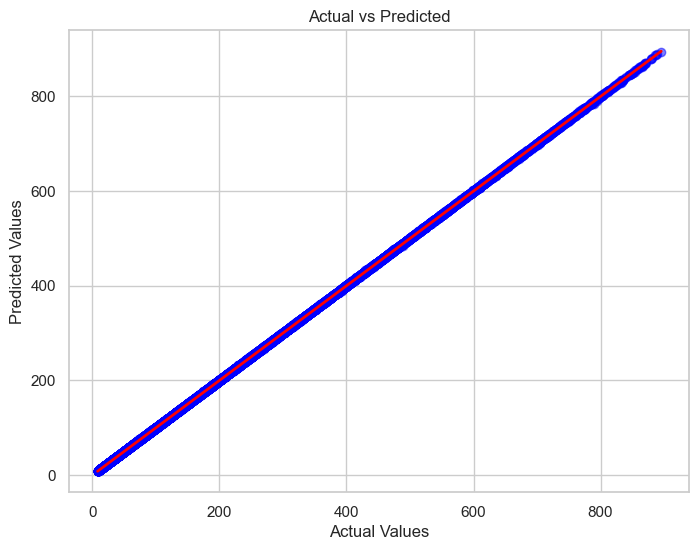

In [406]:
plt.figure(figsize=(8, 6))
plt.scatter(y_test, y_pred, color='blue', alpha=0.5)  # Scatter plot
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linewidth=2)  # Diagonal line
plt.title('Actual vs Predicted')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.show()

The model performs exceptionally well in predicting the target variable, "JumlahTotal". The low values of MAE, MSE, and RMSE indicate that the average prediction error is very small, and the RMSE shows that predictions are close to the actual values on average. Additionally, the high R2 score near 1.0 indicates that the model explains almost all the variability of the response data around its mean. This suggests that the model is highly accurate and fits the data very well. These results indicate a successful modeling effort with strong predictive performance.